In [51]:
#Downloads what we need for pytorch, the second one is for working with GPU (although I'm not sure if that's 100% correct)

%pip install tensorflow
%pip install tensorflow-datasets
%pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu121
%pip -q install tensorflow-datasets pillow torchvision matplotlib
%pip install einops




Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Looking in indexes: https://download.pytorch.org/whl/cu121
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


In [52]:
import tensorflow_datasets as tfds #this allows us to get the dataset directly from tensorflow (so CLIC)
#Lowkey the best option might be to install it on our PC/Laptops but like this is technically an option lmao
import numpy as np #numpy lol
from PIL import Image #lets us convert numpy arrays into images
import torch, torch.nn as nn #import numpy

import torch.nn.functional as F #this one is to unfold the patches from their mid token form (for bug testing the encoder basically)

from torchvision import transforms #easy conversion into tensors
import matplotlib.pyplot as plt #matlab lol

from torch.utils.data import Dataset, DataLoader
import torch.optim as optim
from skimage.metrics import peak_signal_noise_ratio as psnr, structural_similarity as ssim
import os, glob
import math


In [53]:
import torch, sys

print("torch version:", torch.__version__)
print("torch.cuda.is_available():", torch.cuda.is_available())
print("torch.version.cuda:", torch.version.cuda)
print("sys.executable:", sys.executable)

torch version: 2.5.1+cu121
torch.cuda.is_available(): True
torch.version.cuda: 12.1
sys.executable: c:\Users\Yu Xuan Liu\AppData\Local\Programs\Python\Python311\python.exe


In [54]:
class PatchEmbed(nn.Module):
    """
    Conv2D-based patchify:
    - Splits (B, C, H, W) into patches of size patch_size x patch_size. So in our case it would be 32 x 32 to keep it small
    - Projects each patch into an embedding vector of dimension embed_dim

     B: Batch Size
     C: Image Channels
     H: Image Height
     W: Image Width

    """
    def __init__(self, img_size, patch_size, in_chans, embed_dim):
        # Save attributes for future reference
        self.patch_size = patch_size    # Patch size
        self.embed_dim = embed_dim      # Dimensionality of Model
        self.img_size = img_size        # Image Size
        self.in_chans = in_chans        # Number of Channels

        super().__init__()

        # Conv2d layer: kernel_size = stride = patch_size
        # → splits the image into non-overlapping patches
        # → each patch is projected into `embed_dim` features
        # Basically this is taking a square cookie cutter and then moving it across a big square cookie till u got 16 patches of 32 x 32
        self.proj = nn.Conv2d(in_chans, embed_dim,
                              kernel_size=patch_size,
                              stride=patch_size)

    def forward(self, x):
        # Input x: (B, C, H, W)
        print(x.shape)
        x = self.proj(x)                        # after conv: (B, embed_dim, grid_h, grid_w)
        x = x.flatten(2).transpose(1, 2)        # flatten spatial grid, then swap → (B, N, D)
                                               # B = batch, N = num_patches, D = embed_dim
        return x
    
    def unpatchify(patches, embed_layer, in_chans):
        """
        Unpatchify it so i can make sure this actually works
        """
        B, N, D = patches.shape                 # (batch, num_patches, embed_dim)
        gh, gw = embed_layer.grid_h, embed_layer.grid_w  # retrieve patch grid dimensions
        return gh, gw                           # just return patch layout info (for visualization checks)

In [55]:
class PositionalEncoding(nn.Module):
    """
    ViTs have no inherent understanding of spatial structure, hence
    we add positional encodings to each patch so that the ViT model can understand
    where each patch is located in respect to the original image.

    We will be making the positional encodings learnable, as this is a better fit for
    the task of image compression.
    
    NOTE: If we find that our results are iffy, we can switch to static embedding as it
    might work better depending on how much data we have (if we don't have much, static
    positional encoding might help with generalization).

    """

    def __init__(self, sequence_len, embed_dim):

        # sequence_len = number of patches
        super().__init__()
        self.positional_encoding = nn.Parameter(torch.randn(1, sequence_len, embed_dim))  # Learnable pos. encodings

    def forward(self, x):

        # Add positional encoding to embeddings
        # x: (B, N, embed_dim) — N should match sequence_len
        x = x + self.positional_encoding

        return x

In [56]:
class MultiHeadAttention(nn.Module):
    def __init__(self, embed_dim, num_heads):
        super().__init__()
        self.attn = nn.MultiheadAttention(embed_dim, num_heads, batch_first=True)

    def forward(self, x):
        # x: (B, N, D)
        out, _ = self.attn(x, x, x)
        return out

In [57]:
class ViTEncoderBlock(nn.Module):
    """ 
    The features of each patch are tranformed through a Multi-Layer Perceptron (MLP)
    in this class, after each patch attends to the others, and is normalized for
    stabilization and better gradient flow.

    Essentially, passing through this encoder block encodes local, global, and 
    contextual information (from the other patches) into each patch vector...

    """

    def __init__(self, embed_dim, num_heads, r_mlp=4):
        super().__init__()

        # Normalizing the input BEFORE MHA to improve gradient flow
        # This will stabilize each input in the batch independently,
        # across its features.
        self.ln1 = nn.LayerNorm(embed_dim)  

        # Calling the MHA method we built which will output a model
        # of the relationships between the patches
        self.mha = MultiHeadAttention(embed_dim, num_heads)

        # Normalizes the layer again after attention but before the FFN
        self.ln2 = nn.LayerNorm(embed_dim)

        # A simple Feed-Forward Neural Network... a Multi-Layer Perceptron (MLP)
        # to add non-linearity to the features, as well as transform them: 
        # which will help each patch's representation become more learnable...

        # This MLP contains two hidden layers, with a GELU activation in between.
        self.mlp = nn.Sequential(
            nn.Linear(embed_dim, embed_dim * r_mlp),
            nn.GELU(),
            nn.Linear(embed_dim * r_mlp, embed_dim)
        )

    def forward(self, x):

        # Performs the steps outlined in the constructor...
        # 1) Performs MHA with the input layer normalized, and add that to the original input
        x = x + self.mha(self.ln1(x))

        # 2) Normalizes the attended layer, passes that through the MLP, and add that back to the embedding
        x = x + self.mlp(self.ln2(x))

        # note that the shape of x remains the same (B,N,D);
        # the input has just been augmented after being transformed, normalized, and attended
        return x

In [58]:
#Load the CLIC Dataset from Tensorflow Datasets, again i wonder if it would be better to download it lol 
ds = tfds.load("clic", split="train", as_supervised=False, shuffle_files=False)


In [59]:
class ViTCompressor(nn.Module):
  def __init__(self, d_model, img_size, patch_size, n_channels, n_heads, n_layers):
    super().__init__()
    self.img_size = img_size
    self.patch_size = patch_size
    self.n_patches = (img_size[0] // patch_size[0]) * (img_size[1] // patch_size[1])

    self.encoder = PatchEmbed(img_size, patch_size, n_channels, d_model)
    self.pos_encoder = PositionalEncoding(self.n_patches, d_model)

    self.transformer = nn.Sequential(*[
        ViTEncoderBlock(d_model, n_heads) for _ in range(n_layers)
    ])

    hidden = d_model * 4
    self.decoder = nn.Sequential(
        nn.Linear(d_model, hidden),
        nn.ReLU(),
        nn.Linear(hidden, patch_size[0]*patch_size[1]*n_channels)
)

    self.d_model = d_model
    self.n_channels = n_channels

  def forward(self, x):
    B = x.size(0)
    x = self.encoder(x)
    x = self.pos_encoder(x)
    x = self.transformer(x)
    x = self.decoder(x)  # (B, N_patches, patch_dim)
    x = x.transpose(1, 2).contiguous().view(
        B, self.n_channels,
        self.img_size[0] // self.patch_size[0], self.patch_size[0],
        self.img_size[1] // self.patch_size[1], self.patch_size[1]
    )

    # Rearranging patches to image
    x = x.permute(0, 1, 2, 4, 3, 5).contiguous()
    x = x.view(B, self.n_channels, self.img_size[0], self.img_size[1])
    return x
  
# --- 1. Load one example from CLIC ---
ds = tfds.load("clic", split="validation[:1]", as_supervised=False)
example = next(iter(tfds.as_numpy(ds)))       # -> dict with numpy arrays
arr = example["image"]                        # (H, W, 3), uint8

# --- 2. Resize to 832x1472 and convert to torch tensor ---
to_tensor = transforms.Compose([
    transforms.Resize((832, 1472)),   # <--- THIS is the key change
    transforms.ToTensor(),            # (3, 832, 1472), float in [0,1]
])

img = to_tensor(Image.fromarray(arr))   # (3, 832, 1472)
img = img.unsqueeze(0)                  # (1, 3, 832, 1472)

print("Input shape:", img.shape)

# --- 3. Create model instance ---
d_model = 256
img_size = (832, 1472)                  # <--- must match the resize above
patch_size = (16, 16)                   # 832/32=26, 1472/32=46 -> OK
n_channels = 3
n_heads = 4
n_layers = 4

model = ViTCompressor(d_model, img_size, patch_size, n_channels, n_heads, n_layers)

Input shape: torch.Size([1, 3, 832, 1472])


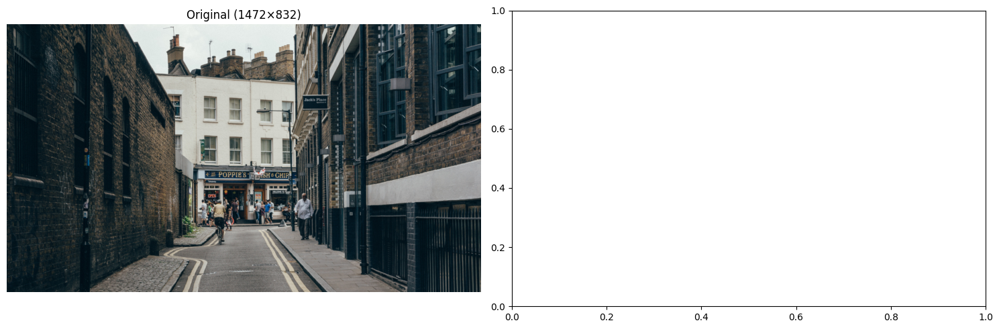

In [60]:
def to_numpy_img(t: torch.Tensor):
    """[1,3,H,W] or [3,H,W] float tensor in [0,1] → HxWx3 numpy"""
    if t.dim() == 4: t = t.squeeze(0)
    t = t.detach().cpu().clamp(0, 1)
    return t.permute(1, 2, 0).numpy()

# get numpy imagesA
img_np   = to_numpy_img(img)           # original
# # error maps, uncomment if u wanna see it
# abs_err  = np.abs(img_np - out_np)                 # per-pixel absolute error
# err_vis  = np.clip(abs_err , 0, 1)           # amplify 10x so you can see artifacts

# show side-by-side + error
fig, axs = plt.subplots(1, 2, figsize=(15, 5))

axs[0].imshow(img_np)
axs[0].set_title(f"Original ({img_np.shape[1]}×{img_np.shape[0]})")
axs[0].axis("off")


plt.tight_layout()
plt.show()

In [ ]:
#Overfit test to make sure the model is capable of learning and getting to a point where we can produce accurate results

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = model.to(device)


x = img.to(device)          # (1, 3, 832, 1472)

criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-3)  # much higher for toy
num_steps = 3000

model.train()
for step in range(num_steps):
    optimizer.zero_grad()
    out = model(x)
    loss = criterion(out, x)
    loss.backward()

    # helps keep transformer stable
    torch.nn.utils.clip_grad_norm_(model.parameters(), 1.0)

    optimizer.step()

    # simple LR decay halfway
    if step == num_steps // 2:
        for g in optimizer.param_groups:
            g["lr"] = 1e-4

    if step % 500 == 0:
        print(f"step {step}: loss={loss.item():.6f}")

In [ ]:
#output the overfit test

model.eval()
with torch.no_grad():
    recon = model(x )

orig_np  = to_numpy_img(x [0])
recon_np = to_numpy_img(recon[0])

plt.figure(figsize=(8,4))
plt.subplot(1,2,1); plt.imshow(orig_np);  plt.title("Original");      plt.axis("off")
plt.subplot(1,2,2); plt.imshow(recon_np); plt.title("Reconstruction"); plt.axis("off")
plt.show()

In [63]:

class KodakDataset(Dataset):
    def __init__(self, root="data_kodak", img_size=(832,1472)):
        self.img_size = img_size

        # Normalize path
        root = os.path.abspath(root)

        # Load PNGs
        self.paths = sorted(glob.glob(os.path.join(root, "*.png")))
        if len(self.paths) == 0:
            raise RuntimeError(f"No PNG images found in: {root}")

    def __len__(self):
        return len(self.paths)

    def __getitem__(self, idx):
        path = self.paths[idx]
        img = Image.open(path).convert("RGB")

        img = np.array(img) / 255.0
        img = torch.tensor(img, dtype=torch.float32).permute(2,0,1)

        img = F.interpolate(
            img.unsqueeze(0),
            size=self.img_size,
            mode="bilinear",
            align_corners=False
        ).squeeze(0)

        return img

class CLICDataset(Dataset):
    def __init__(self, split="train"):
        self.ds = tfds.load("clic", split=split, as_supervised=False)
        self.samples = list(self.ds)

    def __len__(self):
        return len(self.samples)
    
    def __getitem__(self, idx):
        example = self.samples[idx]
        img = np.array(example["image"]) / 255.0  # convert to float [0,1]
        img = torch.tensor(img, dtype=torch.float32).permute(2, 0, 1)  # (C, H, W)

        # resize tensor directly (instead of using T.Resize which expects PIL)
        img = F.interpolate(img.unsqueeze(0), size=(832, 1472), mode='bilinear', align_corners=False).squeeze(0)

        return img  # only return image, no label
    

In [64]:
#Load the datasets
kodak_loader = DataLoader(KodakDataset("./data_kodak", img_size=(832,1472)),
                          batch_size=1, shuffle=False)
train_loader = DataLoader(CLICDataset("train"), batch_size=3, shuffle=True)

In [65]:
#makes sure that I'm using the GPU, exists for checking 
os.makedirs("CheckPoints", exist_ok=True)
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print("Using:", device)

model = model.to(device)

Using: cuda:0


In [ ]:
# Main Training + Validation Loop

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print("Using:", device)

model = model.to(device)
criterion = nn.MSELoss()

# ---- OPTIMIZER & SCHEDULER SETUP ----
base_lr = 3e-4  # higher than 1e-3 was for single-image toy; 3e-4 is good for dataset
optimizer = optim.AdamW(
    model.parameters(),
    lr=base_lr,
    betas=(0.9, 0.95),
    weight_decay=1e-2,   # small regularization; you can lower to 1e-3 if you want
)

num_epochs = 30
steps_per_epoch = len(train_loader)
total_steps = num_epochs * steps_per_epoch

# Cosine LR schedule over all training steps
scheduler = optim.lr_scheduler.CosineAnnealingLR(
    optimizer,
    T_max=total_steps,
)

# Linear warmup for the first warmup_steps steps
warmup_steps = min(1000, total_steps // 10)
global_step = 0

os.makedirs("checkpoints", exist_ok=True)
best_val_loss = float('inf')

for epoch in range(num_epochs): 
    # ---- TRAIN ----
    model.train()
    running_train_loss = 0.0
    n_train = 0

    for imgs in train_loader:
        imgs = imgs.to(device)

        outputs = model(imgs)
        loss = criterion(outputs, imgs)

        optimizer.zero_grad()
        loss.backward()

        # gradient clipping helps with transformer stability
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)

        # ---- WARMUP + COSINE LR ----
        if global_step < warmup_steps:
            # linearly ramp LR from 0 → base_lr
            warmup_factor = float(global_step + 1) / warmup_steps
            lr = base_lr * warmup_factor
            for param_group in optimizer.param_groups:
                param_group["lr"] = lr
        else:
            # after warmup, use cosine schedule
            scheduler.step()

        optimizer.step()
        global_step += 1

        running_train_loss += loss.item() * imgs.size(0)
        n_train += imgs.size(0)

    train_loss = running_train_loss / n_train

    # ---- EVAL ON KODAK ----
    model.eval()
    running_val_loss = 0.0
    n_val = 0

    # for visualization, we'll keep first Kodak image
    first_orig = None
    first_recon = None

    with torch.no_grad():
        for i, imgs in enumerate(kodak_loader):
            imgs = imgs.to(device)
            outputs = model(imgs)
            loss = criterion(outputs, imgs)

            running_val_loss += loss.item() * imgs.size(0)
            n_val += imgs.size(0)

            if i == 0:  # save first image for plotting
                first_orig = imgs.detach().cpu()
                first_recon = outputs.detach().cpu()

    val_loss = running_val_loss / n_val

    print(f"Epoch {epoch+1:3d}: train_loss = {train_loss:.6f} | kodak_loss = {val_loss:.6f}")

    # ---- SAVE CHECKPOINT EVERY EPOCH ----
    checkpoint_path = os.path.join("checkpoints", f"epoch_{epoch+1:03d}.pth")
    torch.save({
        "epoch": epoch + 1,
        "model_state": model.state_dict(),
        "optimizer_state": optimizer.state_dict(),
        "scheduler_state": scheduler.state_dict(),
        "train_loss": train_loss,
        "val_loss": val_loss,
        "global_step": global_step,
    }, checkpoint_path)
    print(f"Saved checkpoint: {checkpoint_path}")

    # ---- Visualization on first Kodak image ----
    if first_orig is not None:
        orig_np  = to_numpy_img(first_orig)
        recon_np = to_numpy_img(first_recon)

        psnr_val = psnr(orig_np, recon_np, data_range=1.0)
        ssim_val = ssim(orig_np, recon_np, channel_axis=2, data_range=1.0)
        err_vis  = np.clip(np.abs(orig_np - recon_np) * 10.0, 0, 1)

        fig, axs = plt.subplots(1, 3, figsize=(15, 5))
        axs[0].imshow(orig_np)
        axs[0].set_title("Kodak original")
        axs[0].axis("off")

        axs[1].imshow(recon_np)
        axs[1].set_title(f"Reconstructed\nPSNR: {psnr_val:.2f} dB | SSIM: {ssim_val:.4f}")
        axs[1].axis("off")

        axs[2].imshow(err_vis)
        axs[2].set_title("Abs Error ×10")
        axs[2].axis("off")

        plt.tight_layout()
        plt.show()

In [67]:
# 1. Recreate the model with EXACT same hyperparameters
best_model = ViTCompressor(
    d_model = 256,
    img_size = (832, 1472) ,                 # <--- must match the resize above
    patch_size = (16, 16) ,                  # 832/32=26, 1472/32=46 -> OK
    n_channels = 3,
    n_heads = 4,
    n_layers = 4
).to(device)

# 2. Load the checkpoint
checkpoint = torch.load("checkpoints/epoch_100.pth", map_location=device)

# 3. Load only the model weights
model.load_state_dict(checkpoint["model_state"])

# 4. Set to evaluation mode
model.eval()

print("Loaded model from epoch:", checkpoint["epoch"])

C:\Users\Yu Xuan Liu\AppData\Local\Temp\ipykernel_209312\812946361.py:12: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load("checkpoints/epoch_100.pth", 

Loaded model from epoch: 100


torch.Size([1, 3, 832, 1472])


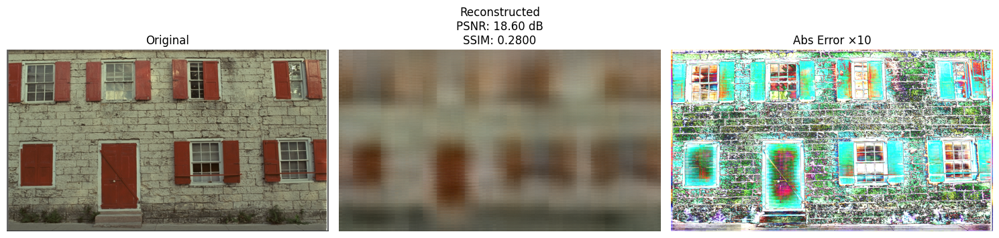

torch.Size([1, 3, 832, 1472])


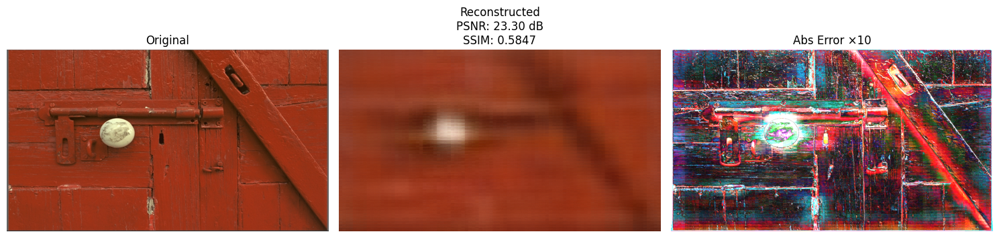

torch.Size([1, 3, 832, 1472])


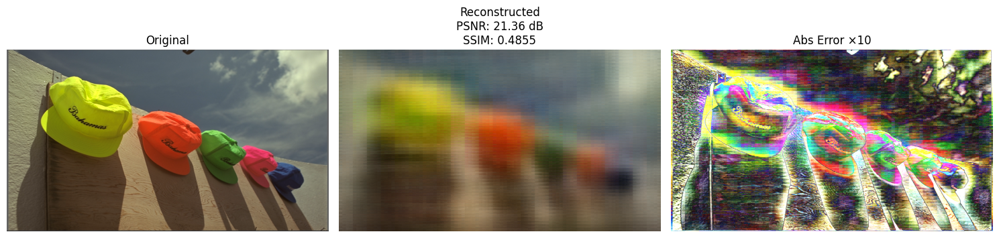

torch.Size([1, 3, 832, 1472])


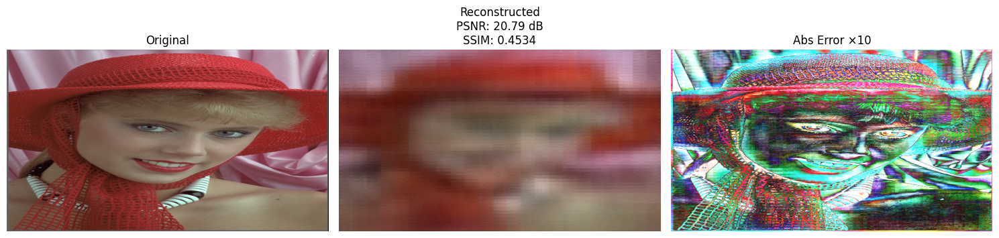

torch.Size([1, 3, 832, 1472])


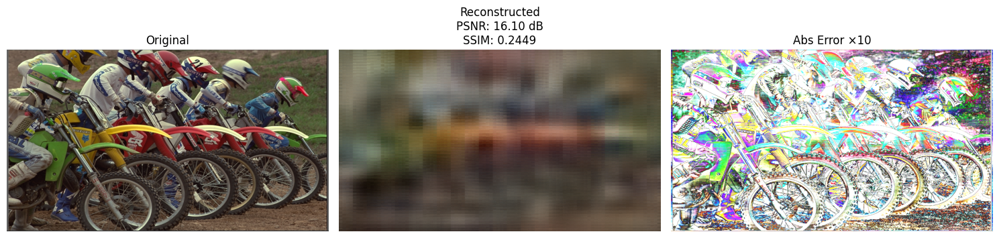

torch.Size([1, 3, 832, 1472])


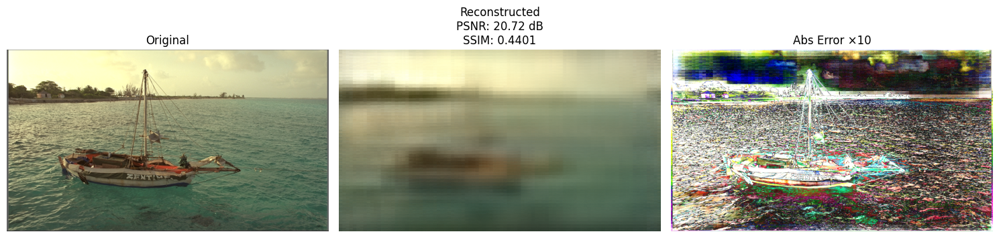

torch.Size([1, 3, 832, 1472])


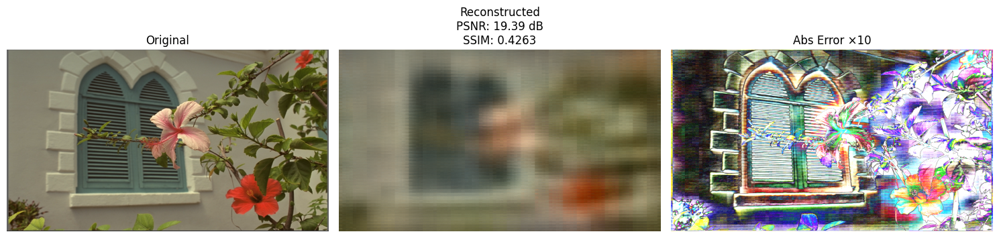

torch.Size([1, 3, 832, 1472])


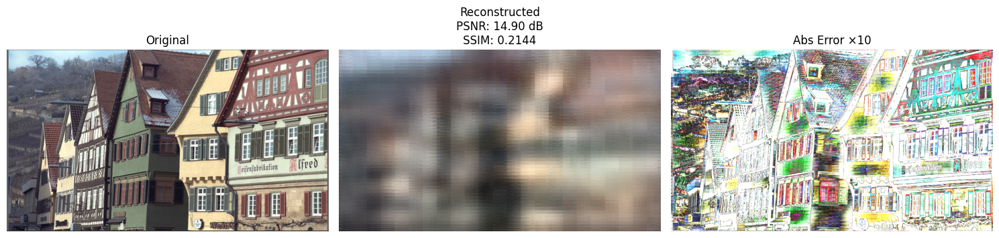

torch.Size([1, 3, 832, 1472])


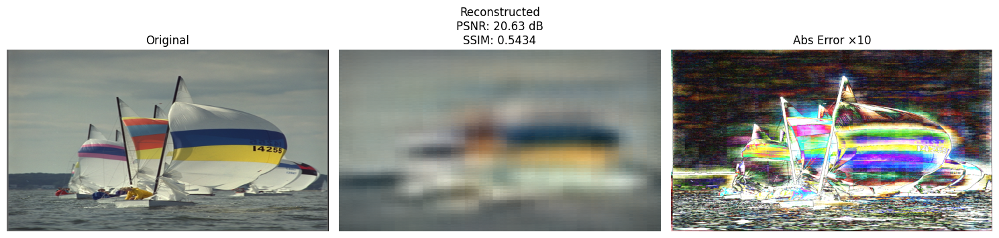

torch.Size([1, 3, 832, 1472])


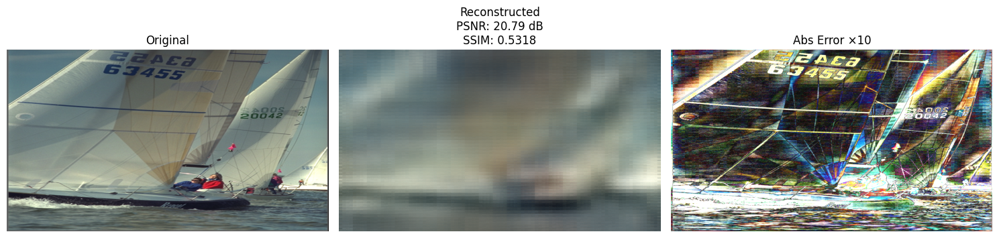

torch.Size([1, 3, 832, 1472])


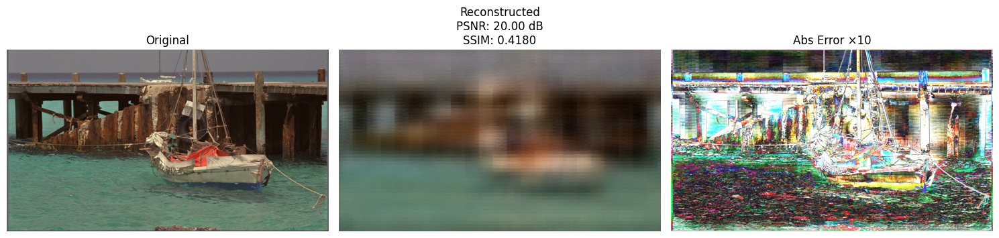

torch.Size([1, 3, 832, 1472])


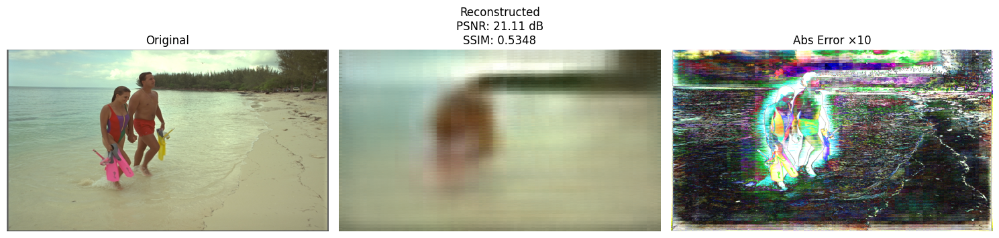

torch.Size([1, 3, 832, 1472])


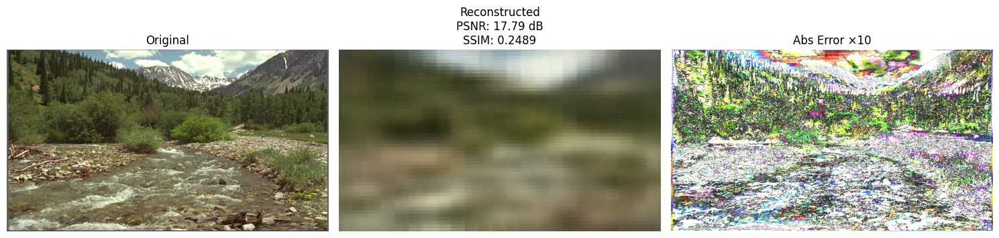

torch.Size([1, 3, 832, 1472])


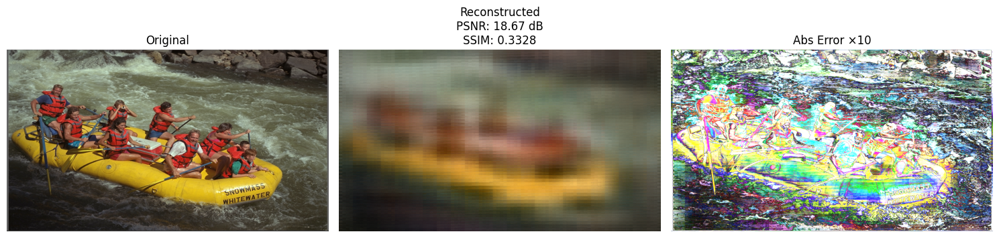

torch.Size([1, 3, 832, 1472])


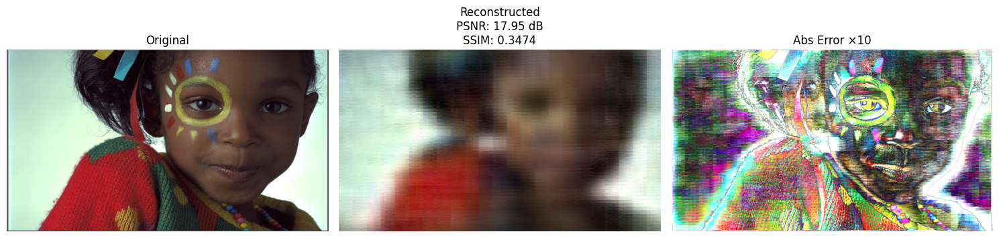

torch.Size([1, 3, 832, 1472])


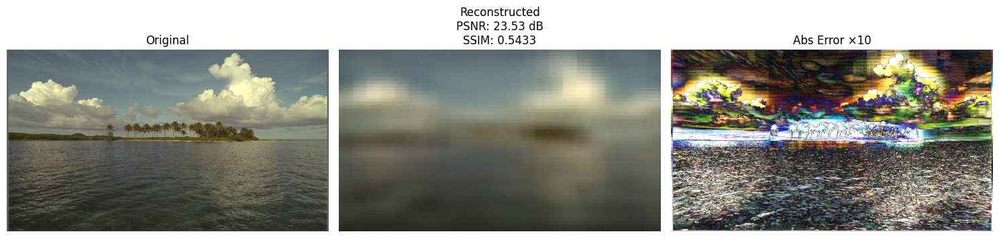

torch.Size([1, 3, 832, 1472])


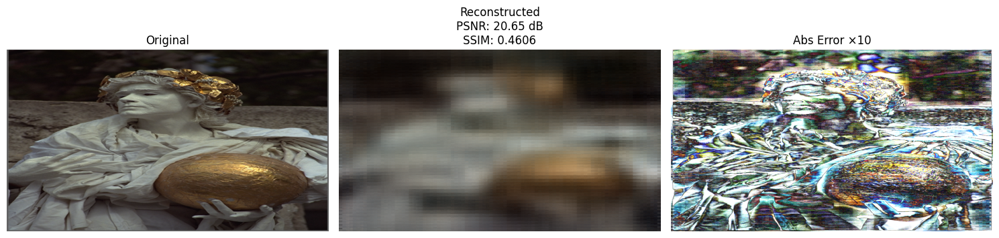

torch.Size([1, 3, 832, 1472])


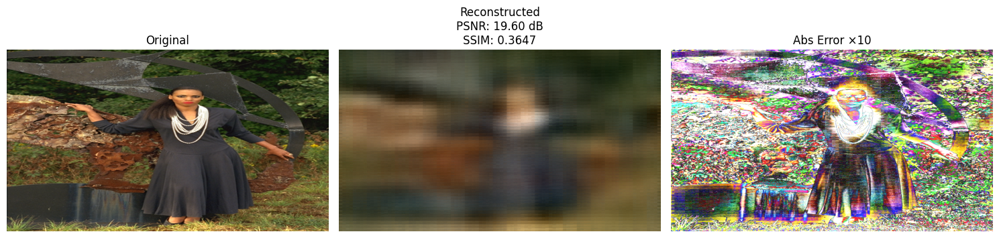

torch.Size([1, 3, 832, 1472])


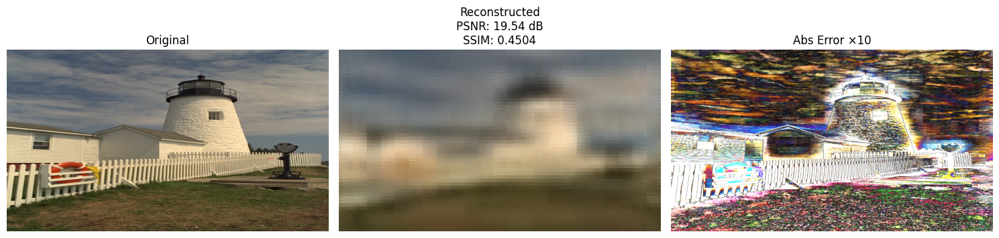

torch.Size([1, 3, 832, 1472])


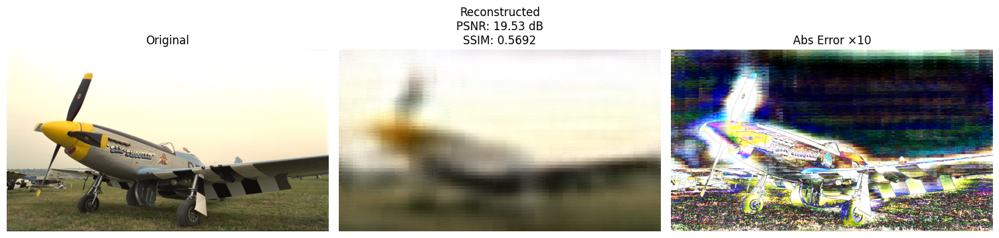

torch.Size([1, 3, 832, 1472])


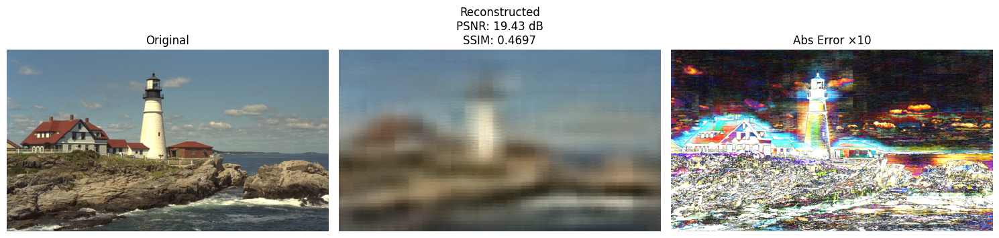

torch.Size([1, 3, 832, 1472])


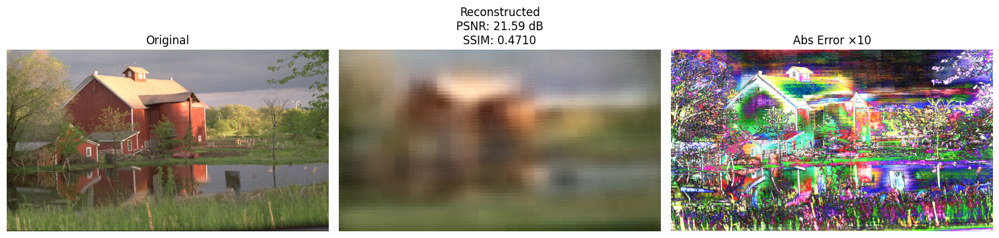

torch.Size([1, 3, 832, 1472])


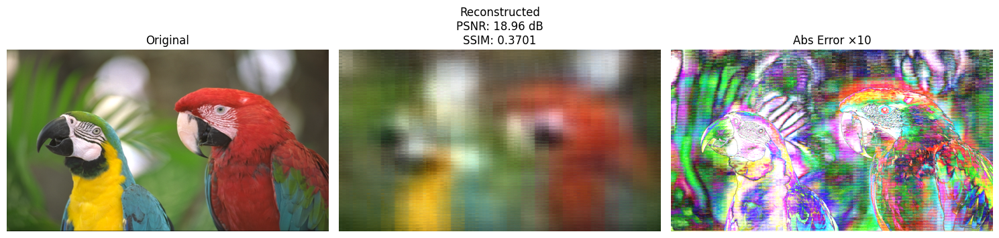

torch.Size([1, 3, 832, 1472])


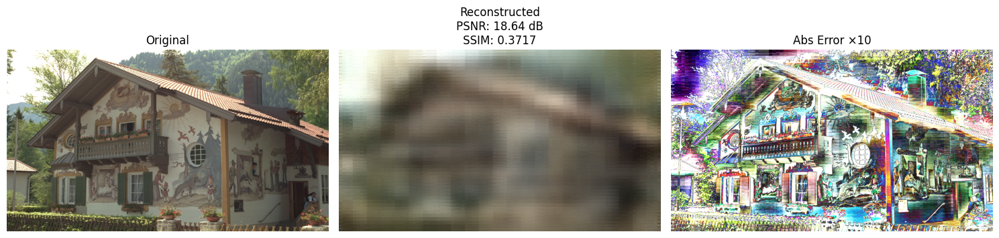


==== FINAL RESULTS ON KODAK ====
Average PSNR: 19.73 dB
Average SSIM: 0.4232


In [68]:
from skimage.metrics import peak_signal_noise_ratio as compute_psnr
from skimage.metrics import structural_similarity as compute_ssim

total_psnr = 0.0
total_ssim = 0.0
count = 0

with torch.no_grad():
    for i, imgs in enumerate(kodak_loader):
        imgs = imgs.to(device)            # [B,3,H,W]
        outputs = model(imgs)             # [B,3,H,W]

        for b in range(imgs.size(0)):
            orig  = imgs[b].unsqueeze(0)
            recon = outputs[b].unsqueeze(0)

            orig_np  = to_numpy_img(orig)
            recon_np = to_numpy_img(recon)

            # use the *functions* we just imported
            psnr_val = compute_psnr(orig_np, recon_np, data_range=1.0)
            ssim_val = compute_ssim(orig_np, recon_np, channel_axis=2, data_range=1.0)

            total_psnr += psnr_val
            total_ssim += ssim_val
            count += 1

            err_vis = np.clip(np.abs(orig_np - recon_np) * 10.0, 0, 1)

            fig, axs = plt.subplots(1, 3, figsize=(15, 5))

            axs[0].imshow(orig_np)
            axs[0].set_title("Original")
            axs[0].axis("off")

            axs[1].imshow(recon_np)
            axs[1].set_title(f"Reconstructed\nPSNR: {psnr_val:.2f} dB\nSSIM: {ssim_val:.4f}")
            axs[1].axis("off")

            axs[2].imshow(err_vis)
            axs[2].set_title("Abs Error ×10")
            axs[2].axis("off")

            plt.tight_layout()
            plt.show()

print(f"\n==== FINAL RESULTS ON KODAK ====")
print(f"Average PSNR: {total_psnr / count:.2f} dB")
print(f"Average SSIM: {total_ssim / count:.4f}")

Evaluating epoch_001 at checkpoints/epoch_001.pth
torch.Size([1, 3, 832, 1472])


C:\Users\Yu Xuan Liu\AppData\Local\Temp\ipykernel_209312\4269514722.py:16: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  ckpt = torch.load(ckpt_path, map_location=device)


torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
  PSNR = 14.15 dB, SSIM = 0.2012
Evaluating epoch_025 at checkpoints/epoch_025.pth
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3, 832, 1472])
torch.Size([1, 3,

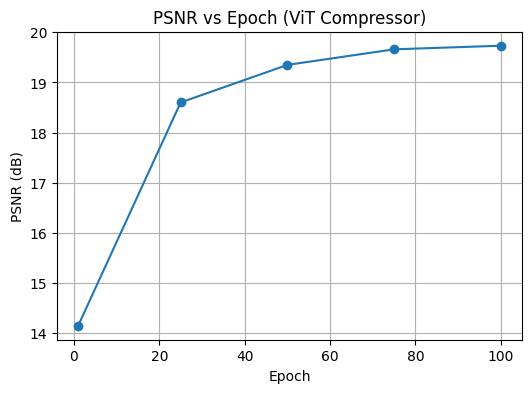

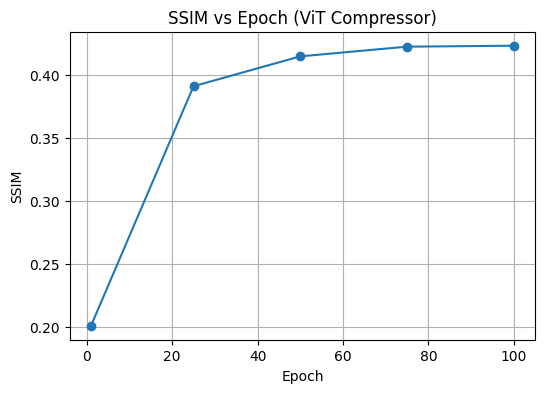

torch.Size([1, 3, 832, 1472])


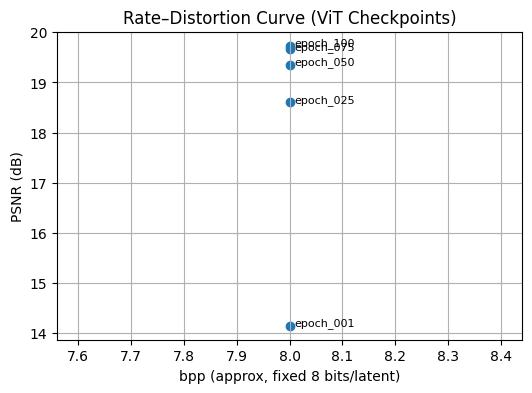

In [81]:
import matplotlib.pyplot as plt
import numpy as np
import torch

# ---- which checkpoints to evaluate ----
checkpoint_files = {
    "epoch_001": "checkpoints/epoch_001.pth",
    "epoch_025": "checkpoints/epoch_025.pth",
    "epoch_050": "checkpoints/epoch_050.pth",
    "epoch_075": "checkpoints/epoch_075.pth",
    "epoch_100": "checkpoints/epoch_100.pth",
}

def eval_checkpoint(ckpt_path):
    """Return (avg_psnr, avg_ssim) on Kodak for a given checkpoint."""
    ckpt = torch.load(ckpt_path, map_location=device)
    model.load_state_dict(ckpt["model_state"])
    model.eval()

    total_psnr = 0.0
    total_ssim = 0.0
    count = 0

    with torch.no_grad():
        for imgs in kodak_loader:              # imgs: [B,3,H,W]
            imgs = imgs.to(device)
            outputs = model(imgs)              # [B,3,H,W]

            for b in range(imgs.size(0)):
                # same conversion as in your working cell
                orig_np  = to_numpy_img(imgs[b].unsqueeze(0))
                recon_np = to_numpy_img(outputs[b].unsqueeze(0))

                psnr_val = compute_psnr(orig_np, recon_np, data_range=1.0)
                ssim_val = compute_ssim(orig_np, recon_np, channel_axis=2, data_range=1.0)

                total_psnr += psnr_val
                total_ssim += ssim_val
                count += 1

    avg_psnr = total_psnr / count
    avg_ssim = total_ssim / count
    return avg_psnr, avg_ssim

# ---- run evaluation for all chosen epochs ----
epochs = []
psnr_vals = []
ssim_vals = []

for name, path in checkpoint_files.items():
    print(f"Evaluating {name} at {path}")
    avg_psnr, avg_ssim = eval_checkpoint(path)
    print(f"  PSNR = {avg_psnr:.2f} dB, SSIM = {avg_ssim:.4f}")

    # extract epoch number from "epoch_XXX"
    epoch_num = int(name.split("_")[1])
    epochs.append(epoch_num)
    psnr_vals.append(avg_psnr)
    ssim_vals.append(avg_ssim)

# sort by epoch for nice plotting
epochs, psnr_vals, ssim_vals = zip(*sorted(zip(epochs, psnr_vals, ssim_vals)))

# ---- PSNR vs Epoch ----
plt.figure(figsize=(6,4))
plt.plot(epochs, psnr_vals, marker="o")
plt.xlabel("Epoch")
plt.ylabel("PSNR (dB)")
plt.title("PSNR vs Epoch (ViT Compressor)")
plt.grid(True)
plt.show()

# ---- SSIM vs Epoch ----
plt.figure(figsize=(6,4))
plt.plot(epochs, ssim_vals, marker="o")
plt.xlabel("Epoch")
plt.ylabel("SSIM")
plt.title("SSIM vs Epoch (ViT Compressor)")
plt.grid(True)
plt.show()

# ---- simple Rate–Distortion curve for these checkpoints ----
# We approximate rate as: 8 bits per latent value (fixed-length code).
# So bpp is constant for this architecture, which matches your old plot.

# get one example batch to compute latent size
model.eval()
with torch.no_grad():
    example_imgs = next(iter(kodak_loader)).to(device)    # [B,3,H,W]
    B, _, H, W = example_imgs.shape
    z = model.encoder(example_imgs)                       # [B, N, D] or [B,C,H',W']
    latents_per_image = z[0].numel()
    fixed_bpp = (latents_per_image * 8) / (H * W)        # 8 bits per latent value

bpp_list = [fixed_bpp] * len(epochs)

plt.figure(figsize=(6,4))
plt.scatter(bpp_list, psnr_vals)
for (bpp, ps, ep) in zip(bpp_list, psnr_vals, epochs):
    plt.text(bpp + 0.01, ps, f"epoch_{ep:03d}", fontsize=8)

plt.xlabel("bpp (approx, fixed 8 bits/latent)")
plt.ylabel("PSNR (dB)")
plt.title("Rate–Distortion Curve (ViT Checkpoints)")
plt.grid(True)
plt.show()
